# Having a look to dark images 


In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
import pandas as pnd
import glob
import os
import h5py

In [3]:
print_pdf = False

# Import the data 

Generated in the file 3.Analytical-distribution....

In [4]:
data = pnd.read_pickle('data_streak_camera_AM.pkl')
data.head()

,BCT_bunchIntensity,BCT_timeStamp_ms,SCtimeAxis,ScImage,Streak_profile,ScImage_ROI,SCtimeAxis_ROI
141.0,17.3335,1.54116e+12,"[0.0, 2.2154144362622312, 4.4308288725244624, ...","[[423.5166495075018, 410.5592469445674, 427.36...","[72646.4204680449, 73011.62070539195, 72906.84...","[[434.59715513173336, 414.6178102190451, 422.5...","[22.15414436262231, 24.36955879888454, 26.5849..."
142.0,20.1471,1.54116e+12,"[0.0, 2.2154144362622312, 4.4308288725244624, ...","[[425.5368114395019, 426.5214473658121, 420.41...","[73254.84910560814, 73592.20863342653, 74275.0...","[[433.72705493675187, 448.546686758655, 442.49...","[22.15414436262231, 24.36955879888454, 26.5849..."
143.0,20.1362,1.54116e+12,"[0.0, 2.2154144362622312, 4.4308288725244624, ...","[[435.51916974900183, 412.53153006484564, 417....","[73800.51587842796, 73617.80987199066, 73430.4...","[[419.64539974320866, 409.64169228212444, 424....","[22.15414436262231, 24.36955879888454, 26.5849..."
144.0,20.0916,1.54116e+12,"[0.0, 2.2154144362622312, 4.4308288725244624, ...","[[438.56201385450197, 446.47104831259026, 410....","[73231.33886066588, 73424.34368941277, 73363.3...","[[448.6234631661366, 438.5401207844867, 426.52...","[22.15414436262231, 24.36955879888454, 26.5849..."
145.0,19.5409,1.54116e+12,"[0.0, 2.2154144362622312, 4.4308288725244624, ...","[[424.5179096282518, 411.5453885047065, 422.37...","[73547.96853759649, 73168.13777710505, 73673.1...","[[413.6499383453615, 403.65296512571507, 420.5...","[22.15414436262231, 24.36955879888454, 26.5849..."


# Data selection:

- Intensity > 15
- Pixel sum in the ROI > 200e6

In [5]:
flags = data['BCT_bunchIntensity'] < 15
data = data.drop(data.loc[flags].index)

In [6]:
flags = data['ScImage_ROI'].apply(lambda x: np.sum(x)) < 200e6
data = data.drop(data.loc[flags].index)

### CHECK ROUTINE --> PRINTS ALL THE IMAGES
# pixel_sum = []
# for k in range(len(data)):
#     #### IMAGE PLOT
#     im = data['ScImage_ROI'].iloc[k]
    
#     pix_sum = np.sum(data['ScImage_ROI'].iloc[k])
#     pixel_sum.append(pix_sum)
    
#     fig, ax = plt.subplots(1, dpi=200)
#     # image plot
#     ax.imshow(im, clim=(0, 30e3))
#     ax.set_title(pix_sum*1e-6)


# Create a second ROI image where there is no beam

In [7]:
# MORE IMAGE PROCESSING
y1 = 450
y2 = 620
x1 = 10
x2 = 510
ROI_bounds = (x1,x2,y1,y2)

def get_longitudinal_profile(image, ROI_bounds):
    '''
    Window the image to the ROI and calculate the profile by summing.
    ROI limits are hardcoded.
    '''
    return np.sum(image[ROI_bounds[2]:ROI_bounds[3], ROI_bounds[0]:ROI_bounds[1]], axis=0)

def get_image_in_ROI(image, ROI_bounds):
    '''
    Return the image subset inside the ROI
    '''
    return image[ROI_bounds[2]:ROI_bounds[3], ROI_bounds[0]:ROI_bounds[1]]


data['Streak_profile_ROI_dark_1'] = data['ScImage'].apply(lambda x: get_longitudinal_profile(x,ROI_bounds))
data['ScImage_ROI_dark_1'] = data['ScImage'].apply(lambda x: get_image_in_ROI(x,ROI_bounds))
data['SCtimeAxis_ROI_dark_1'] = data['SCtimeAxis'].apply(lambda x: x[ROI_bounds[0]:ROI_bounds[1]])


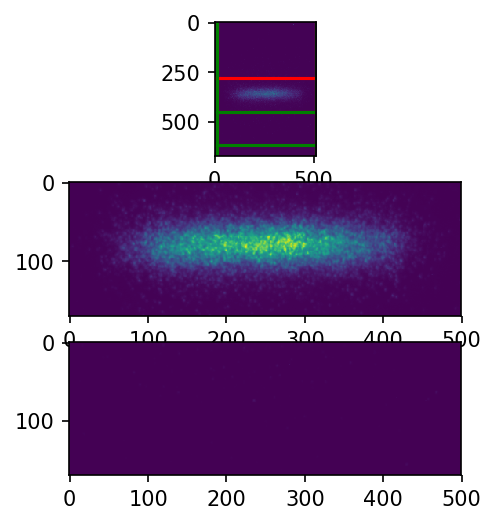

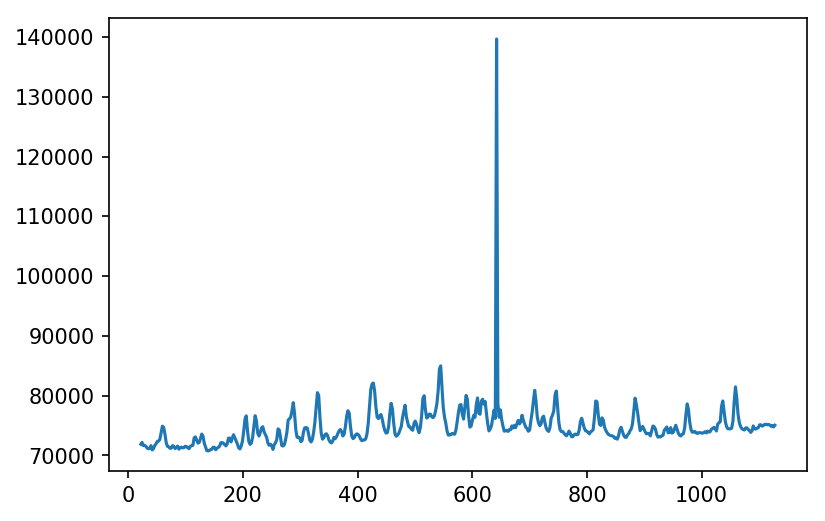

In [8]:
# test
fig, ax = plt.subplots(3,dpi=150)

# full img
ax[0].imshow(data['ScImage'].iloc[0])
#boundaries idx
y1 = 280
y2 = 450
x1 = 10
x2 = 510
ax[0].axvline(x = x1, color='r')
ax[0].axvline(x = x2, color='r')
ax[0].axhline(y = y1, color='r')
ax[0].axhline(y = y2, color='r')

y1 = 450
y2 = 620
ax[0].axvline(x = x1, color='g')
ax[0].axvline(x = x2, color='g')
ax[0].axhline(y = y1, color='g')
ax[0].axhline(y = y2, color='g')

ax[1].imshow(data['ScImage_ROI'].iloc[0])
ax[2].imshow(data['ScImage_ROI_dark_1'].iloc[0])

fig, ax = plt.subplots(1,dpi=150)

ax.plot(data['SCtimeAxis_ROI_dark_1'].iloc[0] ,data['Streak_profile_ROI_dark_1'].iloc[0])

# Get rid of spikes

In [9]:
# thr = 1e5

# fig, ax = plt.subplots(2,dpi=150)

# for k in range(100):
#     xx = data['SCtimeAxis_ROI_dark_1'].iloc[k]
#     yy = data['Streak_profile_ROI_dark_1'].iloc[k]
#     ax[0].plot(xx, yy)
    
#     yy[yy > thr] = np.mean(yy)
#     ax[1].plot(xx, yy)
#     ax[1].set_title('After spike filter')

# fig.tight_layout()

# Cool. Now do the FFT also

No handles with labels found to put in legend.


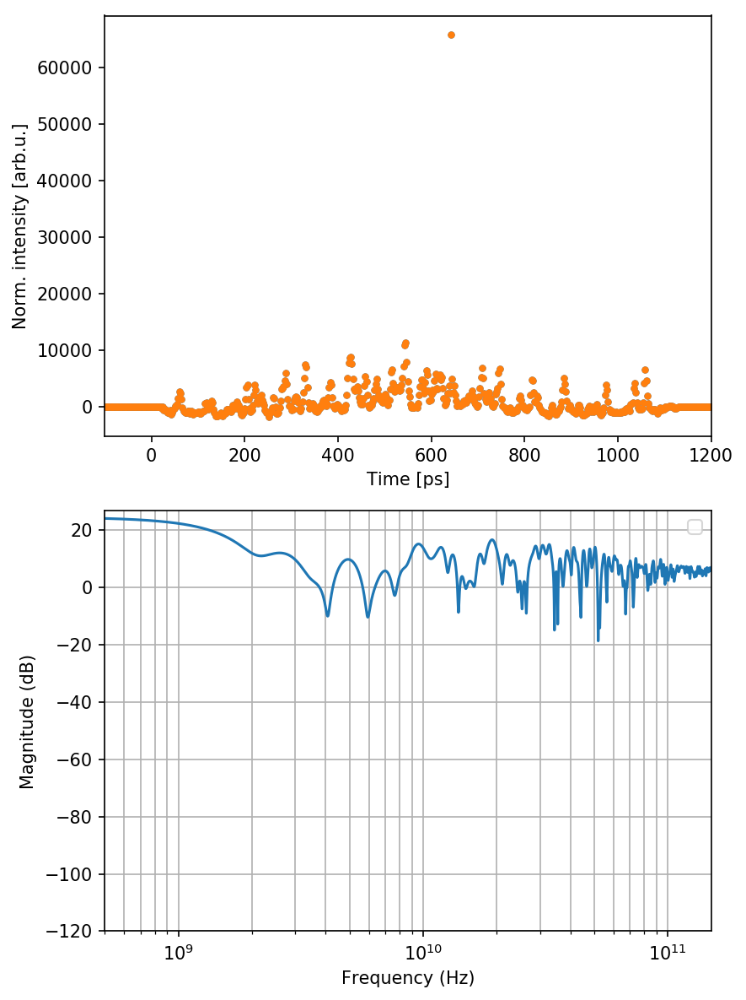

In [10]:
def doFFT(t, y):
    '''
    Do the FFT. Beware there is a factor 2 in the normalisation, so look at the right-hand side of the spectrum only.
    '''
    assert t.size == y.size, 'Different size in X and Y in the doFFT function'
    dt = np.abs(t[1]-t[0])
    N_sample = t.size
    
    norm = 2/N_sample
    
    s_fft = norm*np.abs(np.fft.fft(y))
    f_fft = np.fft.fftfreq(N_sample, d=dt)
    df = np.abs(f_fft[1]-f_fft[0])
    
    # reorder the fft
    f_fft = np.fft.fftshift(f_fft)
    s_fft = np.fft.fftshift(s_fft)

    return f_fft, s_fft

def dB(x):
    return 20*np.log10(x)


##### DEBUG ROUTINE    
final_length = 2**16

k = 0

# for k in range(1):
# baseline from the tails
xx = data['SCtimeAxis_ROI_dark_1'].iloc[k]
yy = data['Streak_profile_ROI_dark_1'].iloc[k] #/ np.max(data['Streak_profile_ROI_dark_1'].iloc[k])

# subset to select tails only
x1 = xx[:20]
x2 = xx[-10:]
xnew = np.concatenate((x1, x2))
y1 = yy[:20]
y2 = yy[-10:]
ynew = np.concatenate((y1, y2))

# fit baseline 
param = np.polyfit(xnew, ynew, 1)

# baseline removed
yy_no_bline = yy - (xx*param[0] + param[1])

# zero padding
assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
pad_len = final_length - len(xx)
yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
dt = xx[1]-xx[0]
xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))




####### PRINTING
fig, ax = plt.subplots(2, dpi=150, figsize=(6,8))
ax[0].plot(xx, yy_zero_pad,'.')
ax[0].set_xlim(-100,1200)
ax[0].set_xlabel('Time [ps]')
ax[0].set_ylabel('Norm. intensity [arb.u.]')

ax[0].plot(xx, yy_zero_pad,'.')

####### FFT
xx = xx*1e-12 # time domain conversion

x_fft, y_fft = doFFT(xx,yy_zero_pad)
ax[1].plot(x_fft, dB(y_fft),'-')
ax[1].set_xlim(5e8, 150e9)
ax[1].set_ylim(-120,)

ax[1].set_xscale('log')
ax[1].grid(which='both')
ax[1].set_ylabel('Magnitude (dB)')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].legend(frameon=True)


fig.tight_layout()



In [11]:
# sloppy way --> Process 'em all !!
data['FFT_freq_ROI_dark_1'] = [np.empty(0)]*len(data)
data['FFT_mag_ROI_dark_1'] = [np.empty(0)]*len(data)

final_length = 2**18

for k in range(len(data)):
    # baseline from the tails
    xx = data['SCtimeAxis_ROI_dark_1'].iloc[k]
    yy = data['Streak_profile_ROI_dark_1'].iloc[k] #/ np.max(data['Streak_profile_ROI_dark_1'].iloc[k])

    # subset to select tails only
    x1 = xx[:20]
    x2 = xx[-10:]
    xnew = np.concatenate((x1, x2))
    y1 = yy[:20]
    y2 = yy[-10:]
    ynew = np.concatenate((y1, y2))

    # fit baseline 
    param = np.polyfit(xnew, ynew, 1)

    # baseline removed
    yy_no_bline = yy - (xx*param[0] + param[1])

    # zero padding
    assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
    pad_len = final_length - len(xx)
    yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
    dt = xx[1]-xx[0]
    xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))

    ####### FFT
    xx = xx*1e-12 # time domain conversion

    x_fft, y_fft = doFFT(xx,yy_zero_pad)    
    
    data['FFT_freq_ROI_dark_1'].iloc[k] = x_fft
    data['FFT_mag_ROI_dark_1'].iloc[k] = y_fft
   

# Ok let's see what came out

Text(0.5, 1.0, 'Dark streak camera images: ROI1 (bottom)')

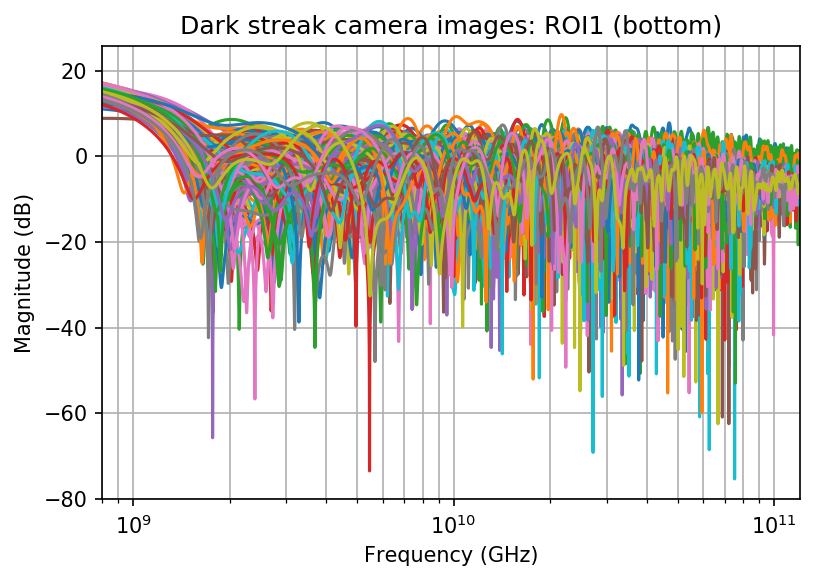

In [12]:
fig, ax = plt.subplots(1, dpi=150)

for k in range(len(data)):
    ax.plot(data['FFT_freq_ROI_dark_1'].iloc[k],dB(data['FFT_mag_ROI_dark_1'].iloc[k]))

ax.set_xlim(0.8e9,120e9)
# ax.set_ylim(-60,0)
ax.set_xlabel('Frequency (GHz)')
ax.set_ylabel('Magnitude (dB)')
ax.set_xscale('log')
ax.grid(which='both')
ax.set_title('Dark streak camera images: ROI1 (bottom)')

# plt.savefig('Proton-streak-all.png',format='png',dpi=150)

# Same story for the beam data

In [13]:
# sloppy way --> Process 'em all !!
data['FFT_freq_ROI'] = [np.empty(0)]*len(data)
data['FFT_mag_ROI'] = [np.empty(0)]*len(data)

final_length = 2**18

for k in range(len(data)):
    # baseline from the tails
    xx = data['SCtimeAxis_ROI'].iloc[k]
    yy = data['Streak_profile'].iloc[k] #/ np.max(data['Streak_profile'].iloc[k])

    # subset to select tails only
    x1 = xx[:20]
    x2 = xx[-10:]
    xnew = np.concatenate((x1, x2))
    y1 = yy[:20]
    y2 = yy[-10:]
    ynew = np.concatenate((y1, y2))

    # fit baseline 
    param = np.polyfit(xnew, ynew, 1)

    # baseline removed
    yy_no_bline = yy - (xx*param[0] + param[1])

    # zero padding
    assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
    pad_len = final_length - len(xx)
    yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
    dt = xx[1]-xx[0]
    xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))

    ####### FFT
    xx = xx*1e-12 # time domain conversion

    x_fft, y_fft = doFFT(xx,yy_zero_pad)    
    
    data['FFT_freq_ROI'].iloc[k] = x_fft
    data['FFT_mag_ROI'].iloc[k] = y_fft
   

# Same for the other dark region

Here things are a bit different, as it is necessary to subtract the parabolic background

In [14]:
# MORE IMAGE PROCESSING --> PRODUCE ROI2
y1 = 20
y2 = 220
x1 = 10
x2 = 510
ROI_bounds = (x1,x2,y1,y2)

data['Streak_profile_ROI_dark_2'] = data['ScImage'].apply(lambda x: get_longitudinal_profile(x,ROI_bounds))
data['ScImage_ROI_dark_2'] = data['ScImage'].apply(lambda x: get_image_in_ROI(x,ROI_bounds))
data['SCtimeAxis_ROI_dark_2'] = data['SCtimeAxis'].apply(lambda x: x[ROI_bounds[0]:ROI_bounds[1]])

In [15]:
# thr = 1.5e5

# fig, ax = plt.subplots(2,dpi=150)

# for k in range(100):
#     xx = data['SCtimeAxis_ROI_dark_2'].iloc[k]
#     yy = data['Streak_profile_ROI_dark_2'].iloc[k]
#     ax[0].plot(xx, yy)
    
#     yy[yy > thr] = np.mean(yy)
#     ax[1].plot(xx, yy)
#     ax[1].set_title('After spike filter')

# fig.tight_layout()

No handles with labels found to put in legend.


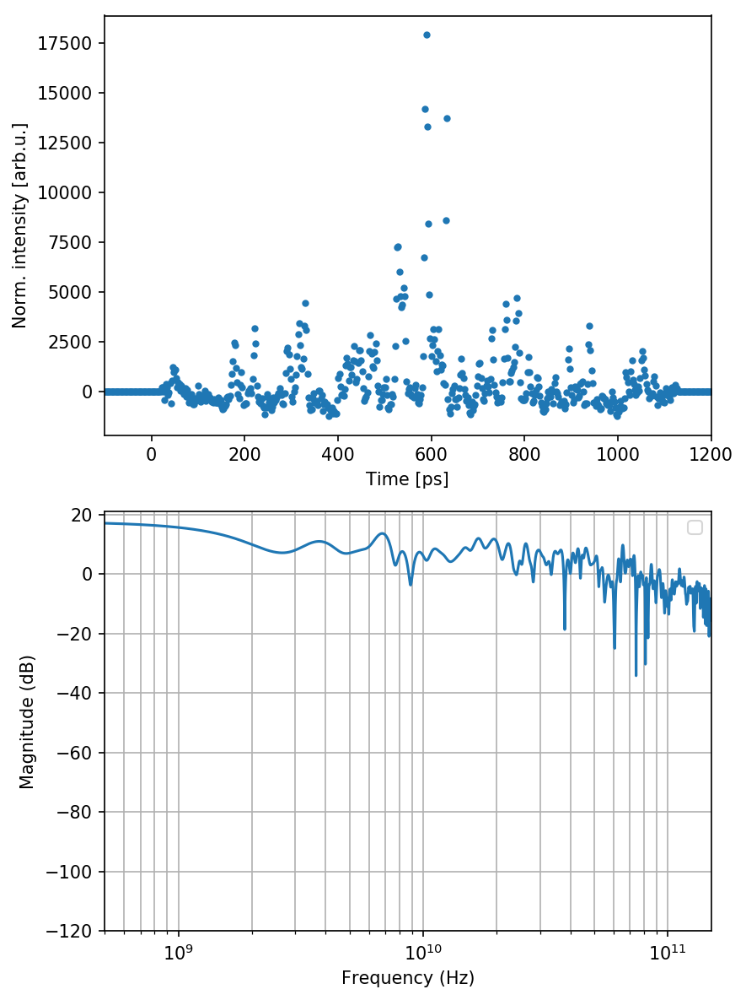

In [16]:
##### DEBUG ROUTINE    
final_length = 2**16

k = 0

# for k in range(1):
# baseline from the tails
xx = data['SCtimeAxis_ROI_dark_2'].iloc[k]
yy = data['Streak_profile_ROI_dark_2'].iloc[k] #/ np.max(data['Streak_profile_ROI_dark_2'].iloc[k])

# subset to select tails only
x1 = xx[:100]
x2 = xx[-100:]
xnew = np.concatenate((x1, x2))
y1 = yy[:100]
y2 = yy[-100:]
ynew = np.concatenate((y1, y2))

# fit baseline 
param = np.polyfit(xnew, ynew, 2)

# baseline removed
yy_no_bline = yy - (xx*xx*param[0] + xx*param[1] + param[2])

# zero padding
assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
pad_len = final_length - len(xx)
yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
dt = xx[1]-xx[0]
xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))






####### PRINTING
fig, ax = plt.subplots(2, dpi=150, figsize=(6,8))
ax[0].plot(xx, yy_zero_pad,'.')
ax[0].set_xlim(-100,1200)
ax[0].set_xlabel('Time [ps]')
ax[0].set_ylabel('Norm. intensity [arb.u.]')


####### FFT
xx = xx*1e-12 # time domain conversion

x_fft, y_fft = doFFT(xx,yy_zero_pad)
ax[1].plot(x_fft, dB(y_fft),'-')
ax[1].set_xlim(5e8, 150e9)
ax[1].set_ylim(-120,)

ax[1].set_xscale('log')
ax[1].grid(which='both')
ax[1].set_ylabel('Magnitude (dB)')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].legend(frameon=True)


fig.tight_layout()



In [17]:
# sloppy way --> Process 'em all !!
data['FFT_freq_ROI_dark_2'] = [np.empty(0)]*len(data)
data['FFT_mag_ROI_dark_2'] = [np.empty(0)]*len(data)

final_length = 2**18

for k in range(len(data)):
    # baseline from the tails
    xx = data['SCtimeAxis_ROI_dark_2'].iloc[k]
    yy = data['Streak_profile_ROI_dark_2'].iloc[k] #/ np.max(data['Streak_profile_ROI_dark_2'].iloc[k])

    # subset to select tails only
    x1 = xx[:100]
    x2 = xx[-100:]
    xnew = np.concatenate((x1, x2))
    y1 = yy[:100]
    y2 = yy[-100:]
    ynew = np.concatenate((y1, y2))

    # fit baseline 
    param = np.polyfit(xnew, ynew, 2)

    # baseline removed
    yy_no_bline = yy - (xx*xx*param[0] + xx*param[1] + param[2])

    # zero padding
    assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
    pad_len = final_length - len(xx)
    yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
    dt = xx[1]-xx[0]
    xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))

    ####### FFT
    xx = xx*1e-12 # time domain conversion

    x_fft, y_fft = doFFT(xx,yy_zero_pad)    
    
    data['FFT_freq_ROI_dark_2'].iloc[k] = x_fft
    data['FFT_mag_ROI_dark_2'].iloc[k] = y_fft
   

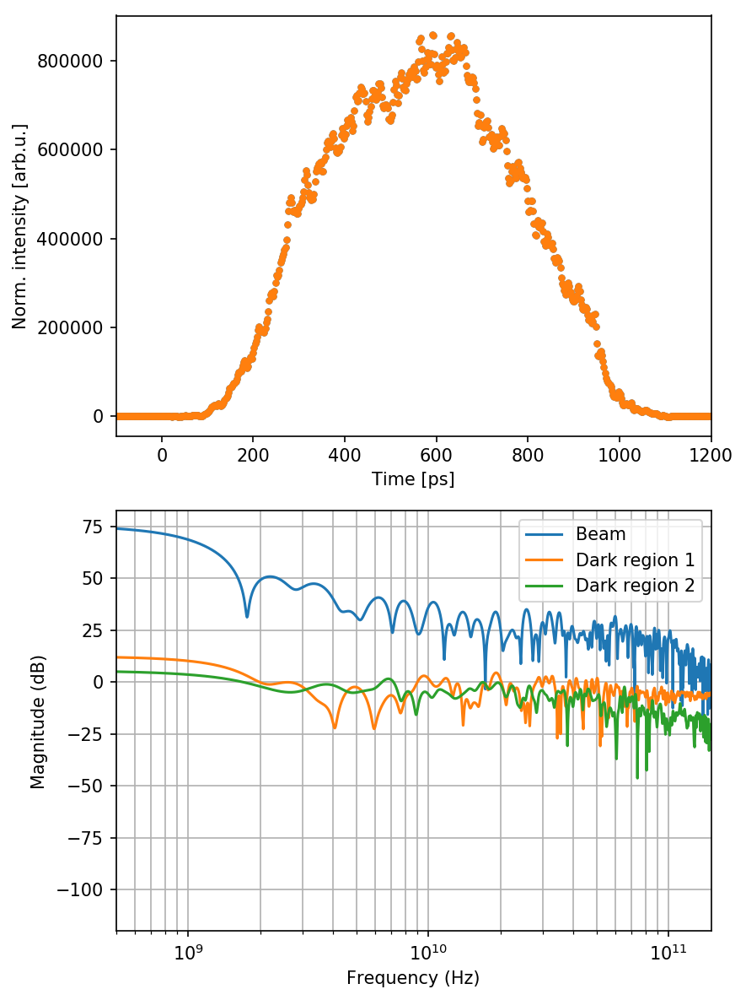

In [18]:
##### DEBUG ROUTINE    
final_length = 2**16

k = 0

# for k in range(1):
# baseline from the tails
xx = data['SCtimeAxis_ROI'].iloc[k]
yy = data['Streak_profile'].iloc[k] #/ np.max(data['Streak_profile'].iloc[k])

# subset to select tails only
x1 = xx[:20]
x2 = xx[-10:]
xnew = np.concatenate((x1, x2))
y1 = yy[:20]
y2 = yy[-10:]
ynew = np.concatenate((y1, y2))

# fit baseline 
param = np.polyfit(xnew, ynew, 1)

# baseline removed
yy_no_bline = yy - (xx*param[0] + param[1])

# zero padding
assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
pad_len = final_length - len(xx)
yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
dt = xx[1]-xx[0]
xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))






####### PRINTING
fig, ax = plt.subplots(2, dpi=150, figsize=(6,8))
ax[0].plot(xx, yy_zero_pad,'.')
ax[0].set_xlim(-100,1200)
ax[0].set_xlabel('Time [ps]')
ax[0].set_ylabel('Norm. intensity [arb.u.]')

ax[0].plot(xx, yy_zero_pad,'.')

####### FFT
xx = xx*1e-12 # time domain conversion

x_fft, y_fft = doFFT(xx,yy_zero_pad)
ax[1].plot(x_fft, dB(y_fft),'-', label='Beam')

ax[1].plot(data['FFT_freq_ROI_dark_1'].iloc[k], dB(data['FFT_mag_ROI_dark_1'].iloc[k]),label='Dark region 1')
ax[1].plot(data['FFT_freq_ROI_dark_2'].iloc[k], dB(data['FFT_mag_ROI_dark_2'].iloc[k]),label='Dark region 2')


ax[1].set_xlim(5e8, 150e9)
ax[1].set_ylim(-120,)

ax[1].set_xscale('log')
ax[1].grid(which='both')
ax[1].set_ylabel('Magnitude (dB)')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].legend(frameon=True)

fig.tight_layout()

Bum


/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Bum


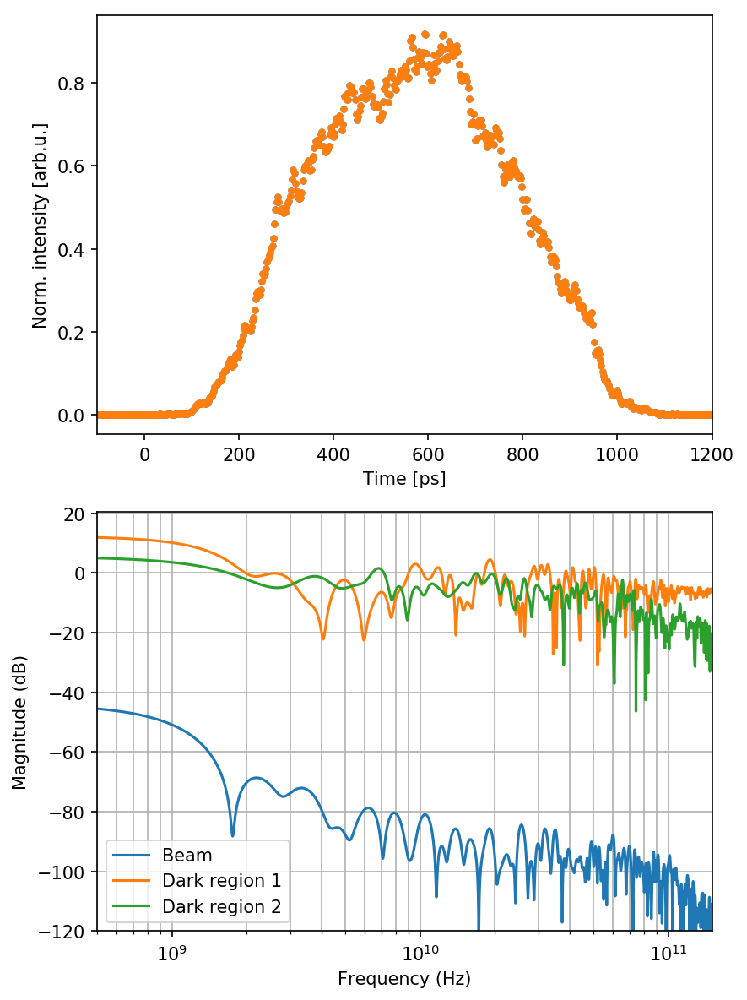

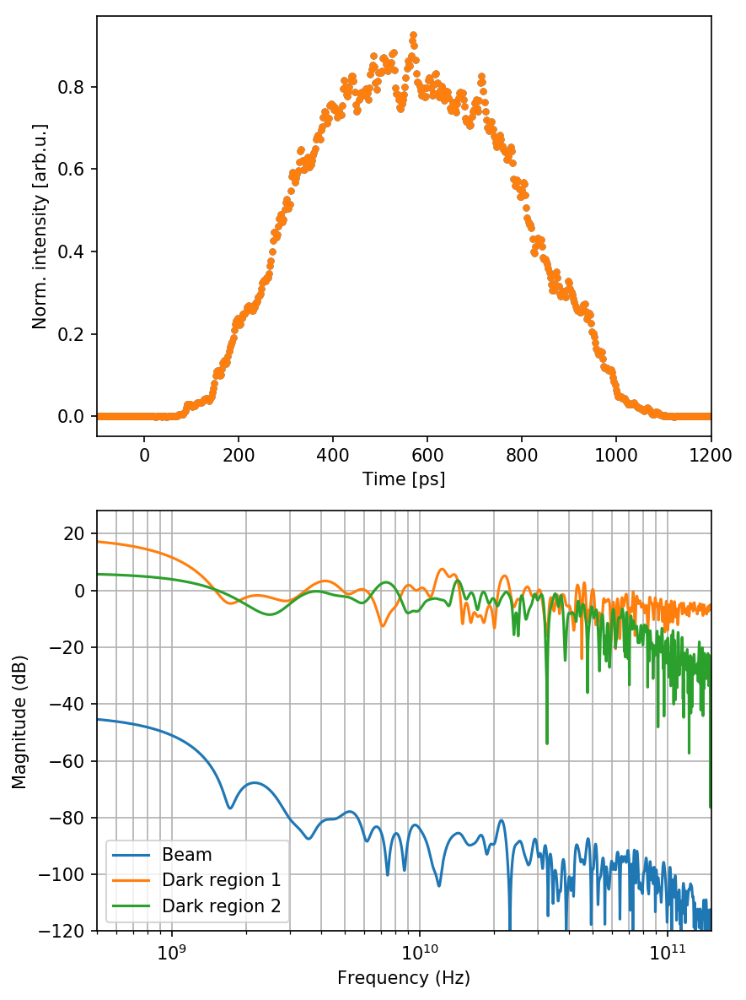

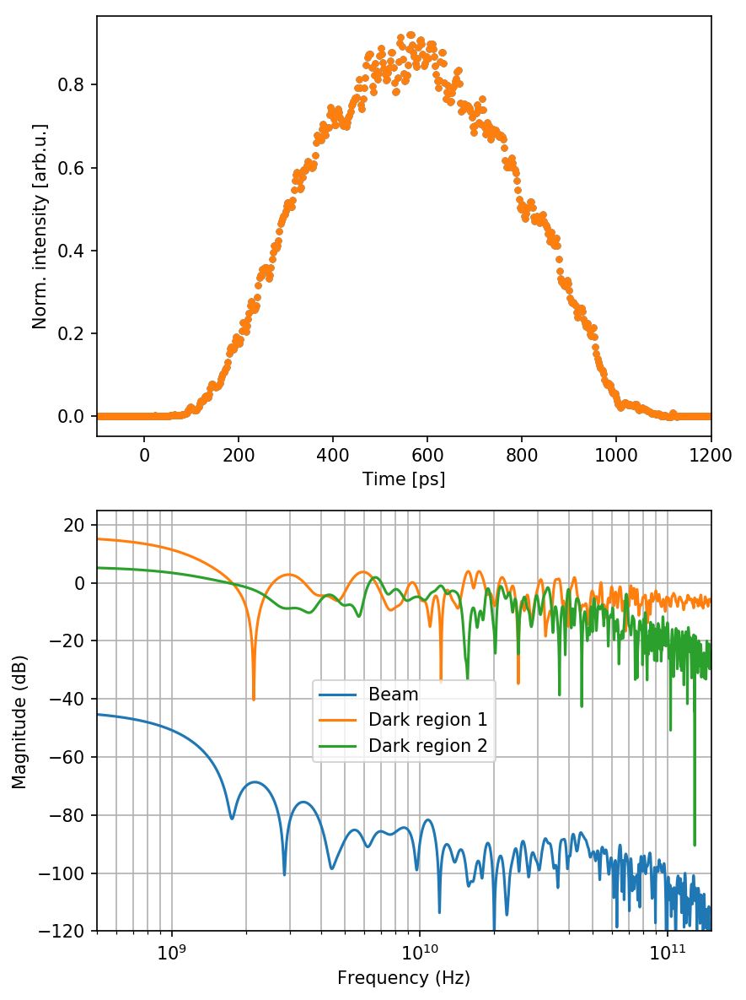

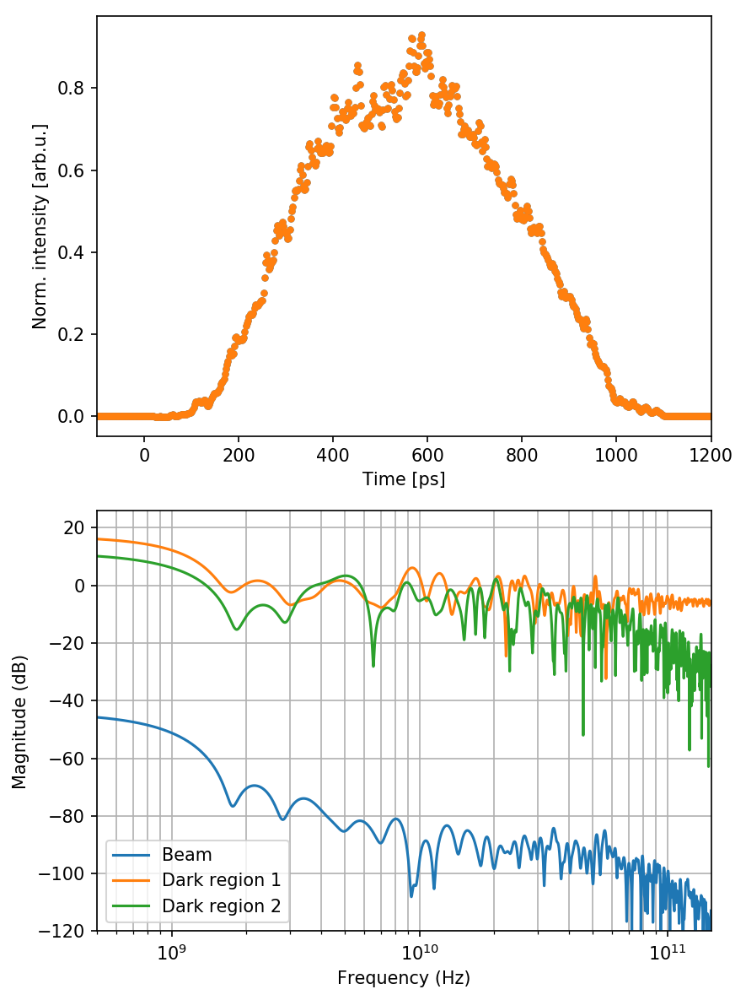

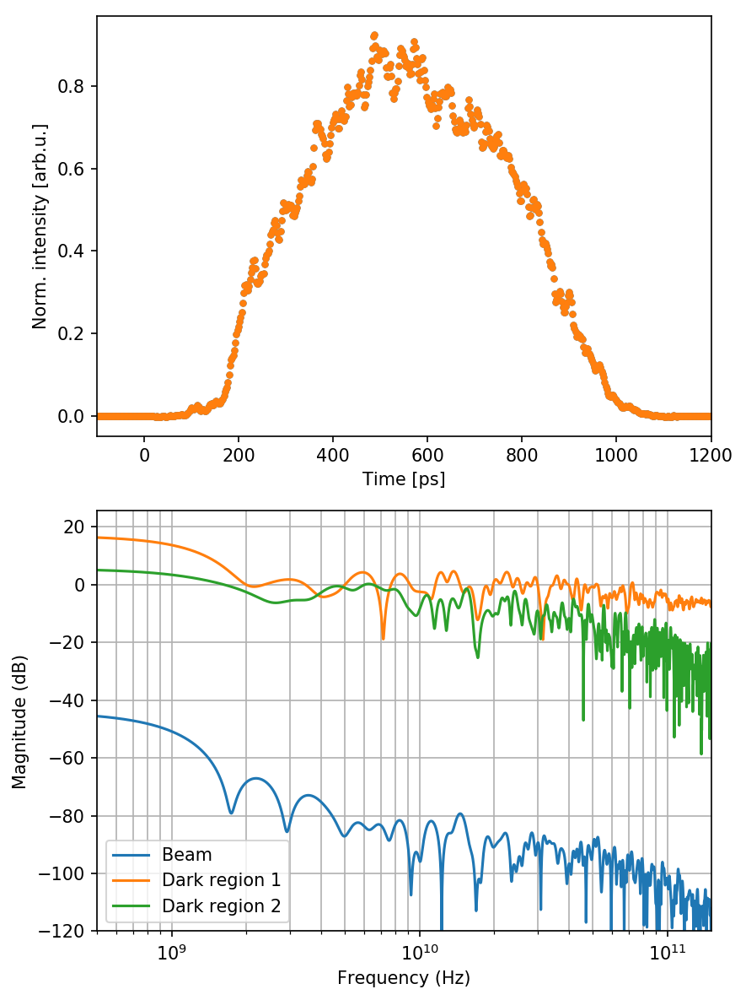

...

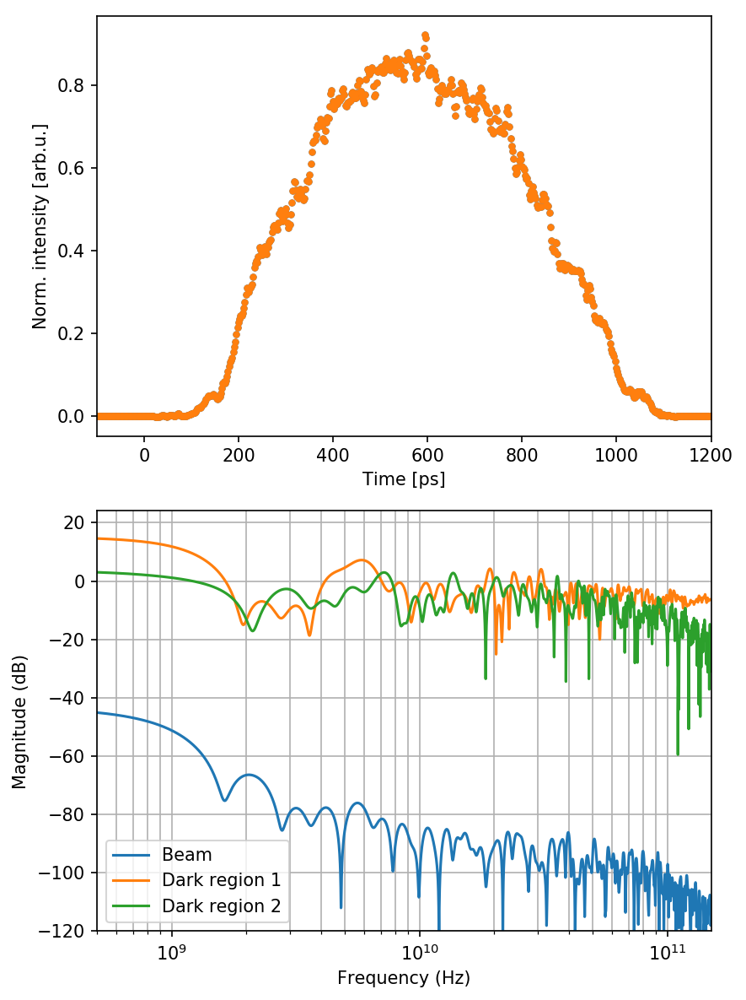

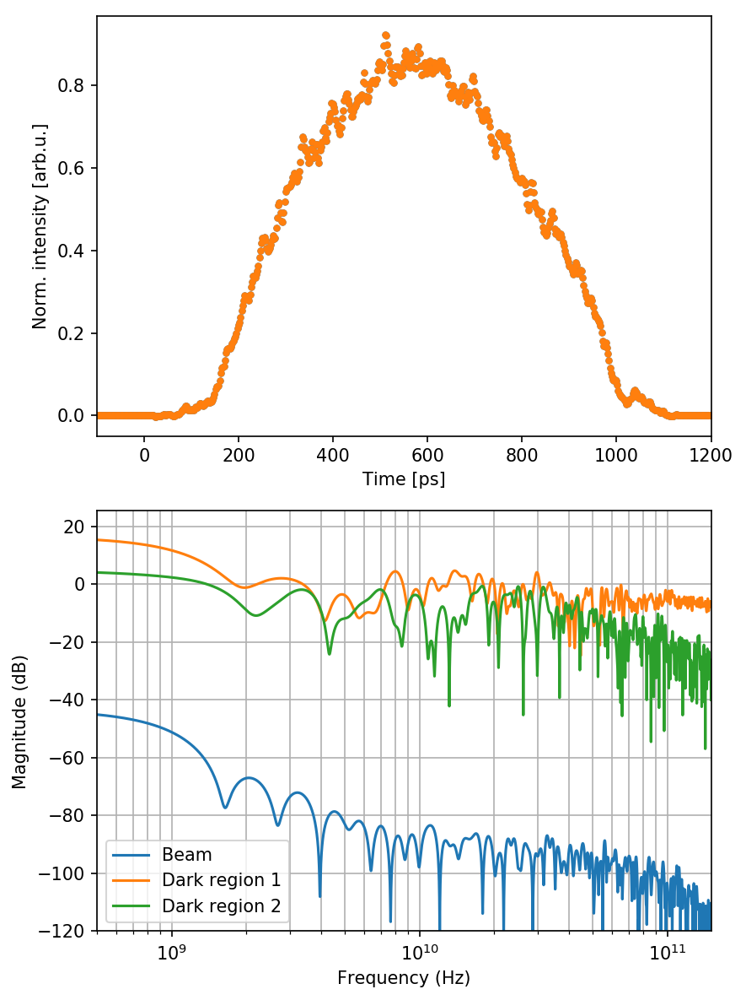

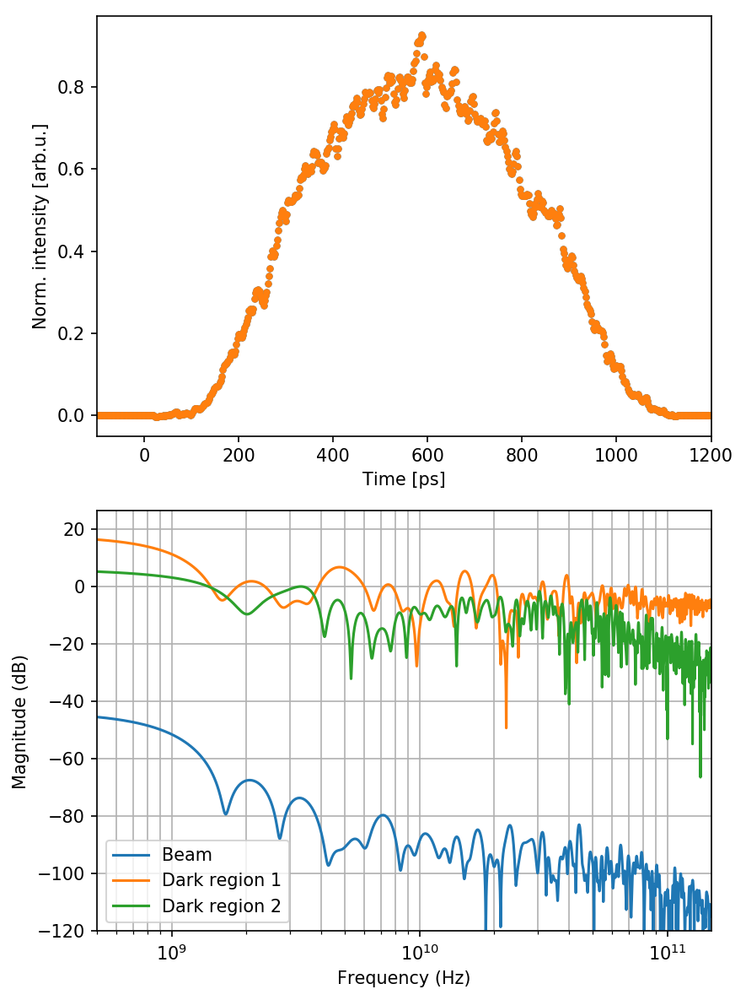

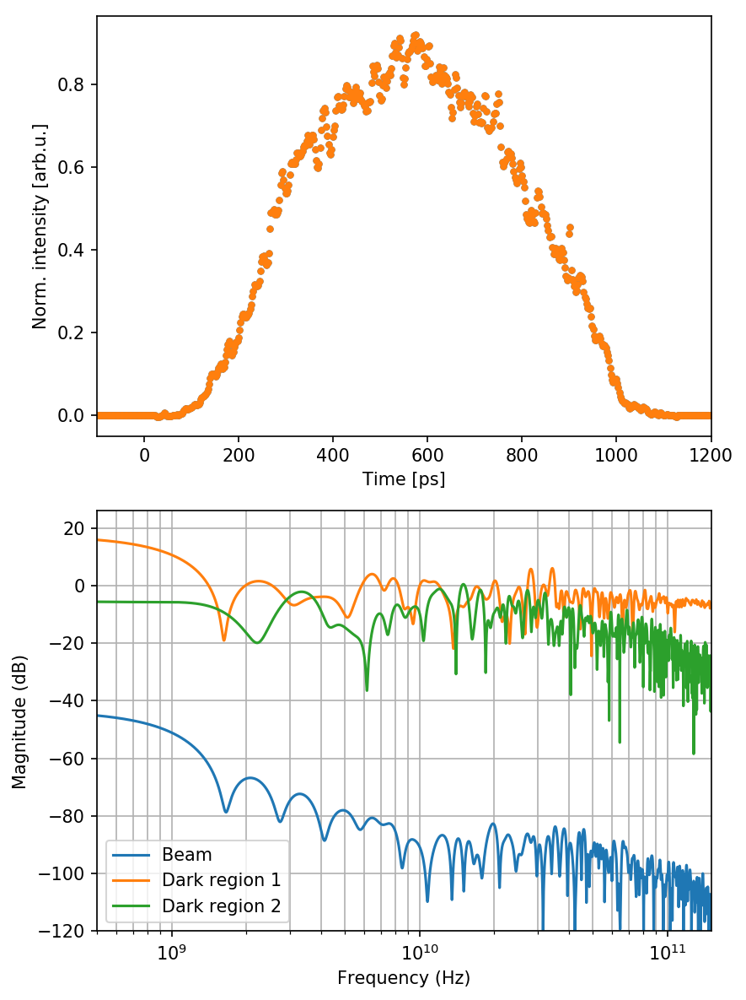

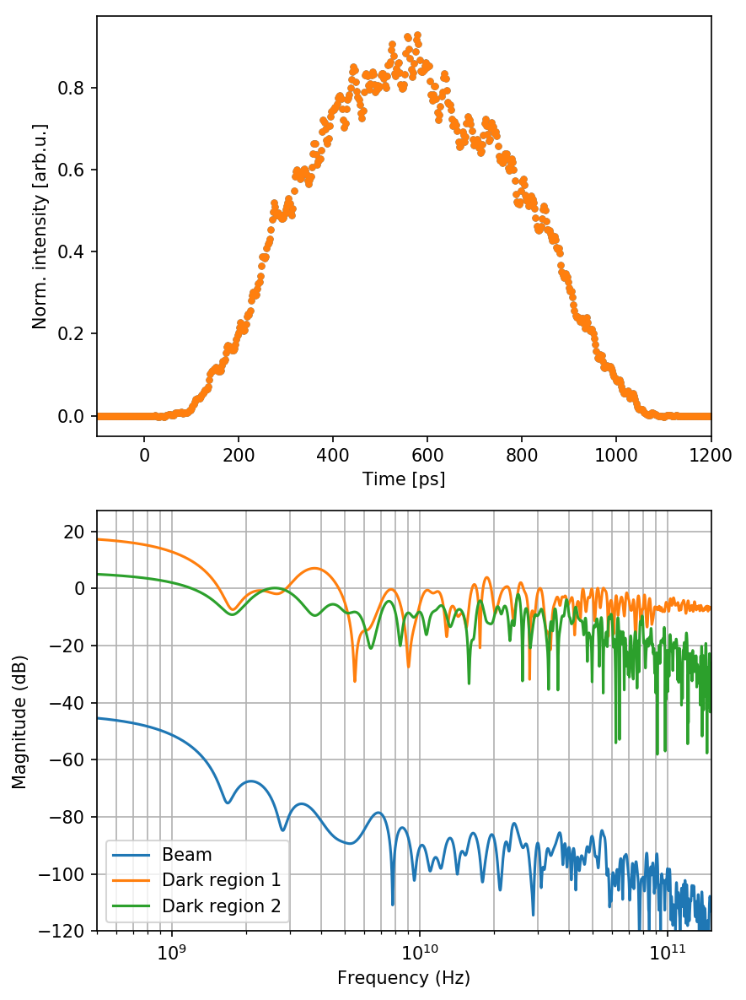

In [21]:
# pdf dump
if print_pdf:
    #init
    from matplotlib.backends.backend_pdf import PdfPages
    pdf_report = PdfPages('streak_camera_with_dark_no_spike_filter.pdf')

    ##### DEBUG ROUTINE    
    final_length = 2**16
    
    for k in range(len(data)):
        if np.mod(k,100)==0:
            print('Bum')
        # baseline from the tails
        xx = data['SCtimeAxis_ROI'].iloc[k]
        yy = data['Streak_profile'].iloc[k] / np.max(data['Streak_profile'].iloc[k])

        # subset to select tails only
        x1 = xx[:20]
        x2 = xx[-10:]
        xnew = np.concatenate((x1, x2))
        y1 = yy[:20]
        y2 = yy[-10:]
        ynew = np.concatenate((y1, y2))

        # fit baseline 
        param = np.polyfit(xnew, ynew, 1)

        # baseline removed
        yy_no_bline = yy - (xx*param[0] + param[1])

        # zero padding
        assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
        pad_len = final_length - len(xx)
        yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
        dt = xx[1]-xx[0]
        xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))






        ####### PRINTING
        fig, ax = plt.subplots(2, dpi=150, figsize=(6,8))
        ax[0].plot(xx, yy_zero_pad,'.')
        ax[0].set_xlim(-100,1200)
        ax[0].set_xlabel('Time [ps]')
        ax[0].set_ylabel('Norm. intensity [arb.u.]')

        ax[0].plot(xx, yy_zero_pad,'.')

        ####### FFT
        xx = xx*1e-12 # time domain conversion

        x_fft, y_fft = doFFT(xx,yy_zero_pad)
        ax[1].plot(x_fft, dB(y_fft),'-', label='Beam')

        ax[1].plot(data['FFT_freq_ROI_dark_1'].iloc[k], dB(data['FFT_mag_ROI_dark_1'].iloc[k]),label='Dark region 1')
        ax[1].plot(data['FFT_freq_ROI_dark_2'].iloc[k], dB(data['FFT_mag_ROI_dark_2'].iloc[k]),label='Dark region 2')


        ax[1].set_xlim(5e8, 150e9)
        ax[1].set_ylim(-120,)

        ax[1].set_xscale('log')
        ax[1].grid(which='both')
        ax[1].set_ylabel('Magnitude (dB)')
        ax[1].set_xlabel('Frequency (Hz)')
        ax[1].legend(frameon=True)

        fig.tight_layout()

        ### ADD PDF PAGE
        pdf_report.savefig(fig)
        del(fig)
    
    pdf_report.close()


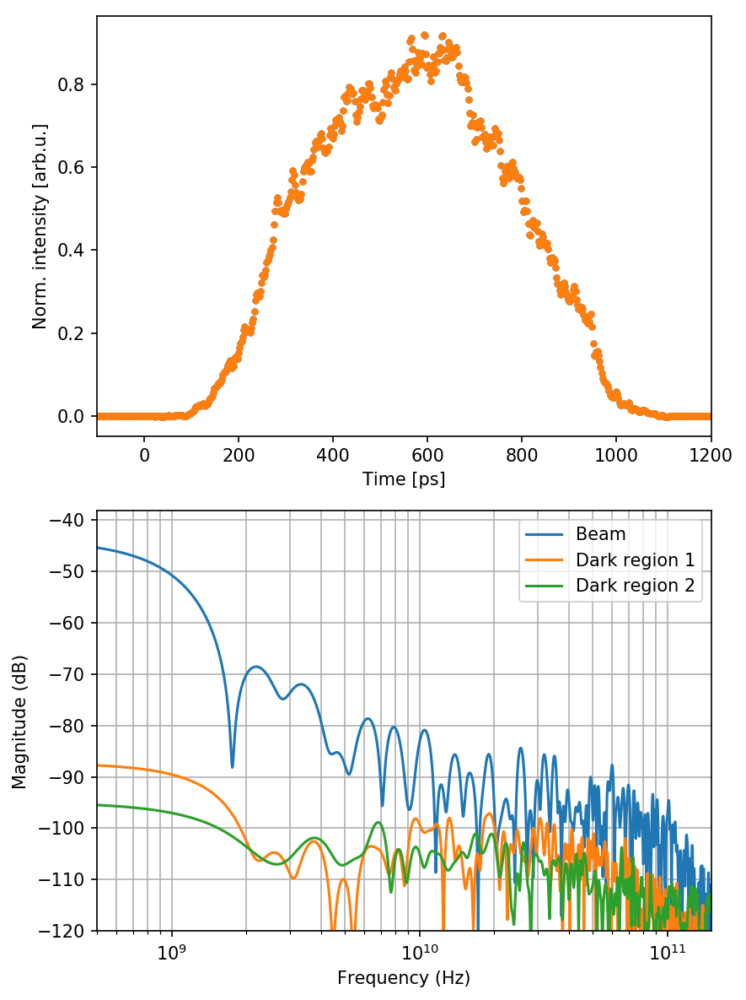

In [152]:
##### DEBUG ROUTINE    
final_length = 2**16

k = 0

# for k in range(1):
# baseline from the tails
xx = data['SCtimeAxis_ROI'].iloc[k]
yy = data['Streak_profile'].iloc[k] / np.max(data['Streak_profile'].iloc[k])

# subset to select tails only
x1 = xx[:20]
x2 = xx[-10:]
xnew = np.concatenate((x1, x2))
y1 = yy[:20]
y2 = yy[-10:]
ynew = np.concatenate((y1, y2))

# fit baseline 
param = np.polyfit(xnew, ynew, 1)

# baseline removed
yy_no_bline = yy - (xx*param[0] + param[1])

# zero padding
assert (final_length > len(xx)) & (np.mod(final_length-len(xx),2) == 0)
pad_len = final_length - len(xx)
yy_zero_pad = np.concatenate((np.zeros(int(pad_len/2)), yy_no_bline, np.zeros(int(pad_len/2))))
dt = xx[1]-xx[0]
xx = np.concatenate((np.linspace(xx[0]-(pad_len/2)*dt, xx[0]-dt, int(pad_len/2)), xx, np.linspace(xx[-1]+dt, xx[-1]+(pad_len/2)*dt, int(pad_len/2))))






####### PRINTING
fig, ax = plt.subplots(2, dpi=150, figsize=(6,8))
ax[0].plot(xx, yy_zero_pad,'.')
ax[0].set_xlim(-100,1200)
ax[0].set_xlabel('Time [ps]')
ax[0].set_ylabel('Norm. intensity [arb.u.]')

ax[0].plot(xx, yy_zero_pad,'.')

####### FFT
xx = xx*1e-12 # time domain conversion

x_fft, y_fft = doFFT(xx,yy_zero_pad)
ax[1].plot(x_fft, dB(y_fft),'-', label='Beam')

ax[1].plot(data['FFT_freq_ROI_dark_1'].iloc[k], dB(data['FFT_mag_ROI_dark_1'].iloc[k]),label='Dark region 1')
ax[1].plot(data['FFT_freq_ROI_dark_2'].iloc[k], dB(data['FFT_mag_ROI_dark_2'].iloc[k]),label='Dark region 2')


ax[1].set_xlim(5e8, 150e9)
ax[1].set_ylim(-120,)

ax[1].set_xscale('log')
ax[1].grid(which='both')
ax[1].set_ylabel('Magnitude (dB)')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].legend(frameon=True)

fig.tight_layout()

In [ ]:
- try with no spike removal and no normalisation

# Good ! 

## Now let's move on: the idea is to find a time domain fitting function starting from the frequency domain. 

In the frequency domain there are two regimes: 

1) the low frequency, until the ~3-4 GHz, where the envelope function is dominating

2) the high frequency, between say 5-20 GHz, where the microstructure of the bunch is actually contributing very much to the power

## Step 1: normalisation

Bring everything back up to zero dB

In [ ]:
# the maximum is at zero freq anyway
data['FFT_mag_norm'] = data['FFT_mag'].apply(lambda x: x/np.max(x))


In [ ]:
fig, ax = plt.subplots(1, dpi=150)

for k in range(len(data)):
    ax.plot(1e-9*data['FFT_freq'].iloc[k],dB(data['FFT_mag_norm'].iloc[k]))

ax.set_xlim(0,20)
ax.set_ylim(-60,0)
ax.set_xlabel('Frequency (GHz)')
ax.set_ylabel('Magnitude (dB)')
ax.grid(which='both')
ax.set_title('SPS proton spectrum - streak camera')

plt.savefig('Proton-streak-all.png',format='png',dpi=150)

# Step 2: low frequency domain

In [ ]:
fig, ax = plt.subplots(1, dpi=150)

for k in range(len(data)):
    ax.plot(data['FFT_freq'].iloc[k],dB(data['FFT_mag_norm'].iloc[k]))

ax.set_xlim(0,5e9)
ax.set_ylim(-60,0)
ax.grid(which='both')

In [ ]:
# let's check how much the notch is moving first
# minimum between 0 and 2 GHz
notch_f_min = []

for k in range(len(data)):
    idx = np.argmin( dB(data['FFT_mag'].iloc[k])[(data['FFT_freq'].iloc[k] > 0.) & (data['FFT_freq'].iloc[k] < 2e9)] ) 
    notch_f_min.append( data['FFT_freq'].iloc[k][(data['FFT_freq'].iloc[k] > 0.) & (data['FFT_freq'].iloc[k] < 2e9)][idx]  )


In [ ]:
plt.plot(np.array(notch_f_min)*1e-9)
plt.title('First notch position')
plt.ylabel('Notch frequency (GHz)')
plt.xlabel('Sample no.')

# Changed direction again: use the envelope only 

This is because the difference between electrons and protons is already 30 dB, so there is not too much to fit or window ...

In [ ]:
fig, ax = plt.subplots(1, dpi=150)

for k in range(len(data)):
    ax.plot(data['FFT_freq'].iloc[k],dB(data['FFT_mag_norm'].iloc[k]))

ax.set_xlim(0,100e9)
ax.set_ylim(-60,0)
ax.grid(which='both')

ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Magnitude (dB)')

In [ ]:
data['FFT_mag_norm_dB'] = data['FFT_mag_norm'].apply(lambda x: dB(x))
# scan frequency by frequency and get the strongest spectrum
     
# build a matrix
dd = data['FFT_mag_norm_dB'].values 
dn = np.empty([dd.shape[0], dd[0].shape[0]])
for k in range(len(dd)):
    dn[k,:] = dd[k]
    
# get the max column-wise
envelope_dB = np.max(dn, axis=0)

# print the envelope
fig, ax = plt.subplots(1, dpi=150)
ax.plot(1e-9*data['FFT_freq'].iloc[0], envelope_dB)

ax.set_xlim(0,100)
ax.set_ylim(-60,0)
ax.grid(which='both')

ax.set_xlabel('Frequency (GHz)')
ax.set_ylabel('Magnitude (dB)')
ax.set_title('Proton spectrum envelope vs gaussian electron bunch')

# print the electron spectrum 
rr = plt.Rectangle((0, -37.5), 100, 5, color='red',alpha=0.5)
ax.add_patch(rr)
ax.axhline(y=-35, color='red')

plt.savefig('Proton-streak-envelope.png',format='png',dpi=150)

Hmm are we reallhy sure they are 30 dB only ??? 
(gaussian assumptions)

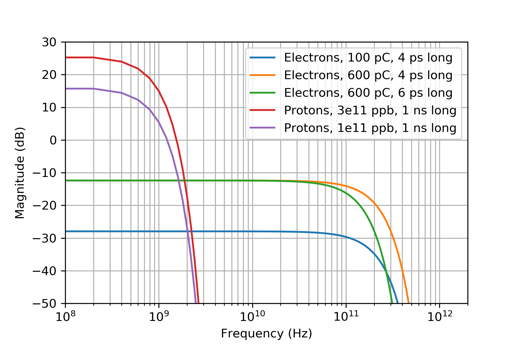

# Same stuff with the envelope, but electron gaussian bunch instead of the line

In [ ]:
def coulomb_to_N(charge):
    '''
    Total bunch charge [C] to number of particles per bunch N
    '''
    from scipy.constants import e
    return charge/e

In [ ]:
s_p = 1e-9/4.
Np = 3e11
tscale = np.linspace(-10.*s_p, 10.*s_p, 2**20)

# proton bunch, just for adjusting the offset
yy_p = current(tscale, Np, 0., s_p)

# electron bunches
Ne_2 = coulomb_to_N(0.6e-9)
sigma_e_2 = 4e-12/4.
yy_e_2 = current(tscale, Ne_2, 0., sigma_e_2)

Ne_3 = coulomb_to_N(0.6e-9)
sigma_e_3 = 6e-12/4.
yy_e_3 = current(tscale, Ne_3, 0., sigma_e_3)

In [ ]:
ff_p, sf_p = doFFT(tscale,yy_p)
ff_e_2, sf_e_2 = doFFT(tscale,yy_e_2)
ff_e_3, sf_e_3 = doFFT(tscale,yy_e_3)

# Normalise the protons to zero 
sf_p_db = dB(sf_p)
sf_e_2_db = dB(sf_e_2)
sf_e_3_db = dB(sf_e_3)

offset = np.max(sf_p_db)
sf_p_db -= offset
sf_e_2_db -= offset
sf_e_3_db -= offset

In [ ]:
# print the envelope
fig, ax = plt.subplots(1, dpi=150)
# ax.plot(1e-9*data['FFT_freq'].iloc[0], envelope_dB, label='Proton envelope')
ax.plot(1e-9*ff_p, sf_p_db,label='Protons')

# print the electrons
ax.plot(1e-9*ff_e_2, sf_e_2_db,label='Electrons, 600 pC, 4 ps long')
ax.plot(1e-9*ff_e_3, sf_e_3_db,label='Electrons, 600 pC, 6 ps long')


# ax.set_xlim(0,150)
ax.set_xscale('log')
ax.set_ylim(-60,0)
ax.grid(which='both')
ax.set_xlabel('Frequency (GHz)')
ax.set_ylabel('Magnitude (dB)')
ax.set_title('Gaussian beams after normalisation')

ax.legend(frameon=True)

# # print the electron spectrum 
# rr = plt.Rectangle((0, -37.5), 100, 5, color='red',alpha=0.5)
# ax.add_patch(rr)
# ax.axhline(y=-35, color='red')

# plt.savefig('Proton-streak-envelope.png',format='png',dpi=150)

In [ ]:
# print the envelope
fig, ax = plt.subplots(1, dpi=150, figsize=(7,7))
ax.plot(1e-9*data['FFT_freq'].iloc[0], envelope_dB, label='Proton envelope')

# print the electrons
ax.plot(1e-9*ff_e_2, sf_e_2_db,label='Electrons, 600 pC, 4 ps long')
ax.plot(1e-9*ff_e_3, sf_e_3_db,label='Electrons, 600 pC, 6 ps long')


ax.set_xlim(0,150)
ax.set_ylim(-60,0)
ax.grid(which='both')

ax.set_xlabel('Frequency (GHz)')
ax.set_ylabel('Magnitude (dB)')
ax.set_title('Proton spectrum envelope vs gaussian electron bunch')

ax.legend(frameon=True)

# # print the electron spectrum 
# rr = plt.Rectangle((0, -37.5), 100, 5, color='red',alpha=0.5)
# ax.add_patch(rr)
# ax.axhline(y=-35, color='red')

plt.savefig('Proton-streak-envelope-vs-gauss-electrons.png',format='png',dpi=150)

In [ ]:
# include the run2 parameters
# electron bunches
Ne_4 = coulomb_to_N(0.1e-9)
sigma_e_4 = 100e-15/4.
yy_e_4 = current(tscale, Ne_4, 0., sigma_e_4)

Ne_5 = coulomb_to_N(0.1e-9)
sigma_e_5 = 50e-15/4.
yy_e_5 = current(tscale, Ne_5, 0., sigma_e_5)

ff_e_4, sf_e_4 = doFFT(tscale,yy_e_4)
ff_e_5, sf_e_5 = doFFT(tscale,yy_e_5)

# Normalise the protons to zero 
sf_p_db = dB(sf_p)
sf_e_4_db = dB(sf_e_4)
sf_e_5_db = dB(sf_e_5)

offset = np.max(sf_p_db)
sf_e_4_db -= offset
sf_e_5_db -= offset

In [ ]:
# print the envelope
fig, ax = plt.subplots(1, dpi=150, figsize=(7,7))
ax.plot(1e-9*data['FFT_freq'].iloc[0], envelope_dB, label='Proton envelope')

# print the electrons RUN1
ax.plot(1e-9*ff_e_2, sf_e_2_db,label='RUN1 electrons, 600 pC, 4 ps long')
# print the electrons RUN2 --> worst case possinble
ax.plot(1e-9*ff_e_4, sf_e_4_db,label='RUN2 electrons, 100 pC, 100 fs long')
ax.plot(1e-9*ff_e_5, sf_e_5_db,label='RUN2 electrons, 100 pC, 50 fs long')




ax.set_xlim(0, 150)
ax.set_ylim(-60,0)
ax.grid(which='both')

ax.set_xlabel('Frequency (GHz)')
ax.set_ylabel('Magnitude (dB)')
ax.set_title('Proton spectrum envelope vs gaussian electron bunch')

ax.legend(frameon=True)

# # print the electron spectrum 
# rr = plt.Rectangle((0, -37.5), 100, 5, color='red',alpha=0.5)
# ax.add_patch(rr)
# ax.axhline(y=-35, color='red')

plt.savefig('Proton-streak-envelope-RUN1-and-2.png',format='png',dpi=150)

In [ ]:
# print the envelope
fig, ax = plt.subplots(1, dpi=150, figsize=(7,7))
ax.plot(1e-9*data['FFT_freq'].iloc[0], envelope_dB, label='Proton envelope')

# print the electrons RUN1
ax.plot(1e-9*ff_e_2, sf_e_2_db,label='RUN1 electrons, 600 pC, 4 ps long')
# print the electrons RUN2 --> worst case possinble
ax.plot(1e-9*ff_e_4, sf_e_4_db,label='RUN2 electrons, 100 pC, 100 fs long')
ax.plot(1e-9*ff_e_5, sf_e_5_db,label='RUN2 electrons, 100 pC, 50 fs long')




ax.set_xlim(0, 1e4)
ax.set_ylim(-60,0)
ax.grid(which='both')

ax.set_xlabel('Frequency (GHz)')
ax.set_xscale('log')
ax.set_xlim(1,)
ax.set_ylabel('Magnitude (dB)')
ax.set_title('Proton spectrum envelope vs gaussian electron bunch')

ax.legend(frameon=True)

# # print the electron spectrum 
# rr = plt.Rectangle((0, -37.5), 100, 5, color='red',alpha=0.5)
# ax.add_patch(rr)
# ax.axhline(y=-35, color='red')

plt.savefig('Proton-streak-envelope-RUN1-and-2-log.png',format='png',dpi=150)